# `xarrayvideo` for the DynamicEarthNet dataset

Note that to run this example, you need to first download the DynamicEarthNet dataset, and then run `scripts/process_dynamicearthnet.py` to convert it to `xarray` and `xarrayvideo` formats. You can find the instructions for doing it easily in the header of said file.

Notebook setup

In [1]:
#Autoreload .py files
%load_ext autoreload
%autoreload 2

#https://github.com/chmp/ipytest/issues/80
import sys
sys.breakpointhook = sys.__breakpointhook__

Load required libraries

In [2]:
import xarray as xr
import numpy as np
from pathlib import Path
from xarrayvideo import xarray2video, video2xarray, gap_fill, plot_image, to_netcdf
import matplotlib.pyplot as plt

Set paths to an example cube

In [3]:
dyn_path= Path('/scratch/users/databases/dynamicearthnet-xarray') / '1417_3281_13.nc' #'1417_3281_13.nc' '2697_3715_13.nc'
output_path= './out'
dyn= xr.open_dataset(dyn_path)
dyn

<xarray.Dataset> Size: 6GB
Dimensions:     (time: 730, y: 1024, x: 1024, time_month: 24)
Coordinates:
  * time        (time) datetime64[ns] 6kB 2018-01-01 2018-01-02 ... 2019-12-31
  * y           (y) int64 8kB 0 1 2 3 4 5 6 ... 1018 1019 1020 1021 1022 1023
  * x           (x) int64 8kB 0 1 2 3 4 5 6 ... 1018 1019 1020 1021 1022 1023
  * time_month  (time_month) datetime64[ns] 192B 2018-01-01 ... 2019-12-01
Data variables:
    B           (time, y, x) int16 2GB ...
    G           (time, y, x) int16 2GB ...
    R           (time, y, x) int16 2GB ...
    NIR         (time, y, x) int16 2GB ...
    labels      (time_month, y, x) int64 201MB ...

## Compress the minicube using `xarray2video`

If you get `ContainsGroupError` when running the commands below, make sure to delete the existing `out` folder:

In [4]:
# Remove out folder to avoid errors
!rm -rf ./out

ffmpeg version 5.1.2 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 11.3.0 (conda-forge gcc 11.3.0-19)
  configuration: --prefix=/home/conda/feedstock_root/build_artifacts/ffmpeg_1674566204550/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_plac --cc=/home/conda/feedstock_root/build_artifacts/ffmpeg_1674566204550/_build_env/bin/x86_64-conda-linux-gnu-cc --cxx=/home/conda/feedstock_root/build_artifacts/ffmpeg_1674566204550/_build_env/bin/x86_64-conda-linux-gnu-c++ --nm=/home/conda/feedstock_root/build_artifacts/ffmpeg_1674566204550/_build_env/bin/x86_64-conda-linux-gnu-nm --ar=/home/conda/feedstock_root/build_artifacts/ffmpeg_1674566204550/_build_env/bin/x86_64-conda-linux-gnu-ar --disable-doc --disable-openssl --enable-demuxer=dash --enable-hardcoded-tables --enable-libfreetype --enable-libfontconfig --enable-libopenh264 --enable-gnu

bands: 5840.00Mb -> ['68.09', '62.62']Mb (showing last 10)(2.24% of original size, 0.3581 bpppb) in 372.68s
 - params={'c:v': 'libx265', 'preset': 'medium', 'crf': [1], 'x265-params': 'qpmin=0:qpmax=0.1:psy-rd=0:psy-rdoq=0', 'tune': 'psnr'}
 - Decompression time 28.56s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


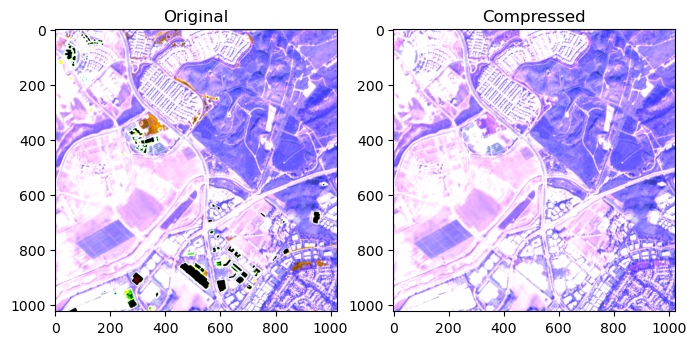

Saturation values per band ['R', 'G', 'B', 'NIR', 'NIR', 'NIR']):
 [[  53. 9408.]
 [  65. 8078.]
 [  71. 8784.]
 [ 434. 9082.]
 [ 434. 9082.]
 [ 434. 9082.]]


/home/oscar/.conda/envs/xv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using only 3.27% of data for metrics computation. Adjust this by modifying global variable METRICS_MAX_N=100000000.0


In [ ]:
lossy_params = {
    'c:v': 'libx265',  #[libx264, libx265, vp9, ffv1]
    'preset': 'medium',  #Preset for quality/encoding speed tradeoff: quick, medium, slow (better)
    'crf': [1],#,1,3,6,9], #14 default, 11 for higher quality and size
    'x265-params': 'qpmin=0:qpmax=0.1:psy-rd=0:psy-rdoq=0',
    'tune': 'psnr',
    }
lossless_params= { 'c:v':'ffv1' }

conversion_rules= {
    'bands': (['R', 'G', 'B', 'NIR'], ('time', 'y', 'x'), 0, lossy_params, 12),
    'labels': ('labels', ('time_month', 'y', 'x'), 0, lossless_params, 8),
    }

dyn['labels']= dyn['labels'].astype(np.uint8)
arr_dict= xarray2video(dyn, 'dyn_test', conversion_rules,
                       output_path=output_path, compute_stats=True,
                       loglevel='verbose', save_dataset=True)  

### Check the actual size of the final files

Compute total size, and observe a signficant compression factor (~25x)

In [15]:
original_path= str(Path(output_path) / f'dyn_test.nc')
!du -h {dyn_path} -d0

3,4G	/scratch/users/databases/dynamicearthnet-xarray/1417_3281_13.nc


In [16]:
new_path= str(Path(output_path) / f'dyn_test')
!du -h {new_path} 

133M	out/dyn_test


## Read the saved videos with `video2xarray`

Read again the written file, and check that everything has persisted

In [17]:
dyn_new= video2xarray(output_path, 'dyn_test', x_name='x', y_name='y', transpose=False)
dyn_new

<xarray.Dataset> Size: 12GB
Dimensions:     (time: 730, y: 1024, x: 1024, time_month: 24)
Coordinates:
  * time        (time) datetime64[ns] 6kB 2018-01-01 2018-01-02 ... 2019-12-31
  * y           (y) int64 8kB 0 1 2 3 4 5 6 ... 1018 1019 1020 1021 1022 1023
  * x           (x) int64 8kB 0 1 2 3 4 5 6 ... 1018 1019 1020 1021 1022 1023
  * time_month  (time_month) datetime64[ns] 192B 2018-01-01 ... 2019-12-01
Data variables:
    R           (time, y, x) float32 3GB 1.136e+03 1.307e+03 ... 1.232e+03
    G           (time, y, x) float32 3GB 914.2 1.069e+03 ... 1.084e+03 984.7
    B           (time, y, x) float32 3GB 654.0 864.6 1.192e+03 ... 862.5 779.5
    NIR         (time, y, x) float32 3GB 2.208e+03 2.153e+03 ... 1.553e+03
    labels      (time_month, y, x) uint8 25MB 4 4 4 4 4 4 2 2 ... 0 0 0 0 0 0 0

In [18]:
#!ffprobe -v error -show_format -show_streams out/dyn_test/bands_001.mkv

## Visualize results

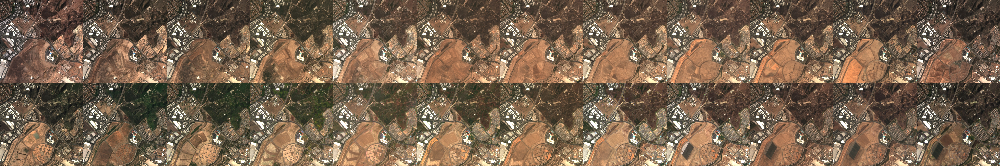

In [19]:
# Plot every 31 days
plot_image(dyn.isel(time=slice(None,None,31)).astype(np.float32)/10000., list('RGB'), 
           mask_name=None, stack_every=12, save_name='./out/RGB_original_dyn.jpg')

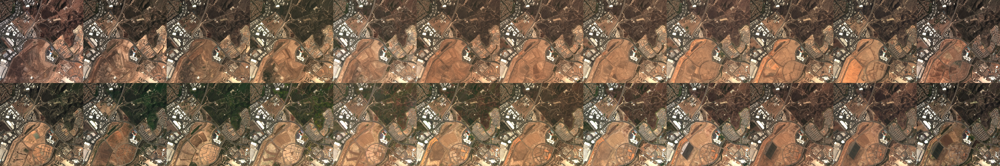

In [20]:
# Plot every 31 days
plot_image(dyn_new.isel(time=slice(None,None,31)).astype(np.float32)/10000., list('RGB'), 
           mask_name=None, stack_every=12, save_name='./out/RGB_compressed_dyn.jpg')

## Test the video-dataset of `DynamicEarthNet`

In [21]:
#Test the generated dataset
datasets_path= Path("/scratch/users/databases/")
output_path_xarray = datasets_path / 'dynamicearthnet-xarray'
output_path_video = datasets_path / 'dynamicearthnet-video-59psnr'
cube= '1417_3281_13' #'1417_3281_13.nc' '2697_3715_13.nc'

In [22]:
dyn= xr.open_dataset(output_path_xarray / f'{cube}.nc')
dyn

<xarray.Dataset> Size: 6GB
Dimensions:     (time: 730, y: 1024, x: 1024, time_month: 24)
Coordinates:
  * time        (time) datetime64[ns] 6kB 2018-01-01 2018-01-02 ... 2019-12-31
  * y           (y) int64 8kB 0 1 2 3 4 5 6 ... 1018 1019 1020 1021 1022 1023
  * x           (x) int64 8kB 0 1 2 3 4 5 6 ... 1018 1019 1020 1021 1022 1023
  * time_month  (time_month) datetime64[ns] 192B 2018-01-01 ... 2019-12-01
Data variables:
    B           (time, y, x) int16 2GB ...
    G           (time, y, x) int16 2GB ...
    R           (time, y, x) int16 2GB ...
    NIR         (time, y, x) int16 2GB ...
    labels      (time_month, y, x) int64 201MB ...

In [23]:
dyn_new= video2xarray(output_path_video, cube, x_name='x', y_name='y', transpose=False)
dyn_new

<xarray.Dataset> Size: 12GB
Dimensions:     (time: 730, y: 1024, x: 1024, time_month: 24)
Coordinates:
  * time        (time) datetime64[ns] 6kB 2018-01-01 2018-01-02 ... 2019-12-31
  * y           (y) int64 8kB 0 1 2 3 4 5 6 ... 1018 1019 1020 1021 1022 1023
  * x           (x) int64 8kB 0 1 2 3 4 5 6 ... 1018 1019 1020 1021 1022 1023
  * time_month  (time_month) datetime64[ns] 192B 2018-01-01 ... 2019-12-01
Data variables:
    R           (time, y, x) float32 3GB 1.136e+03 1.307e+03 ... 1.232e+03
    G           (time, y, x) float32 3GB 914.2 1.069e+03 ... 1.084e+03 984.7
    B           (time, y, x) float32 3GB 654.0 864.6 1.192e+03 ... 862.5 779.5
    NIR         (time, y, x) float32 3GB 2.208e+03 2.153e+03 ... 1.553e+03
    labels      (time_month, y, x) uint8 25MB 4 4 4 4 4 4 2 2 ... 0 0 0 0 0 0 0